In [1]:
import matplotlib.pyplot as plt
import numpy as np
import cv2
import glob
from sklearn.utils import resample
from plot_utils import grid_plot
from image_utils import *
from hog_computation import *

### Exploring data

num vehicle images : 8792
num non vehicle images : 8968
image shape:  (64, 64, 3)


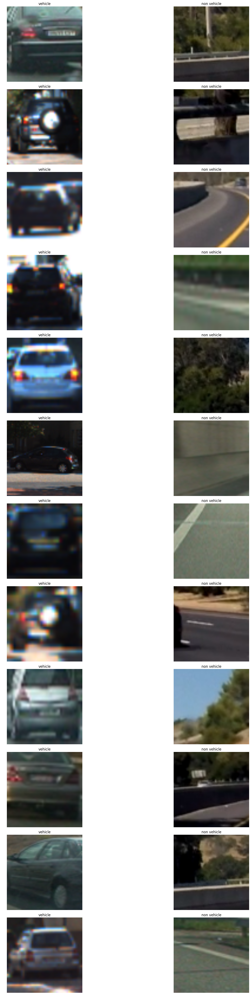

In [2]:
vehicle_paths = glob.glob('../vehicle_detection_data/vehicles/*/*.png')
non_vehicle_paths = glob.glob('../vehicle_detection_data/non-vehicles/*/*.png')

print("num vehicle images : %d"%len(vehicle_paths))
print("num non vehicle images : %d"%len(non_vehicle_paths))

vehicle_sample_images = [read_image_as_rgb(path) for path in 
                         resample(vehicle_paths, n_samples=12, random_state=0)]
non_vehicle_sample_images = [read_image_as_rgb(path) for path in 
                             resample(non_vehicle_paths, n_samples=12, random_state=0)]

print("image shape: ", vehicle_sample_images[0].shape)

grid_plot( [("vehicle", vehicle_sample_images),
           ("non vehicle", non_vehicle_sample_images)])

### Exploring color space transformation

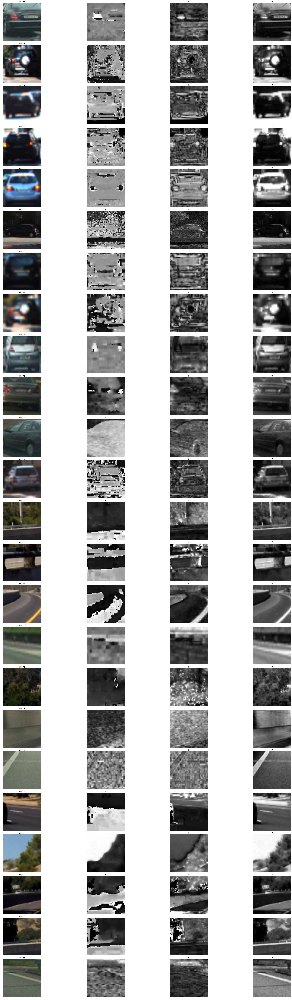

In [3]:
from explore_color_spaces import *
samples = vehicle_sample_images + non_vehicle_sample_images

show_hsv_images(samples)

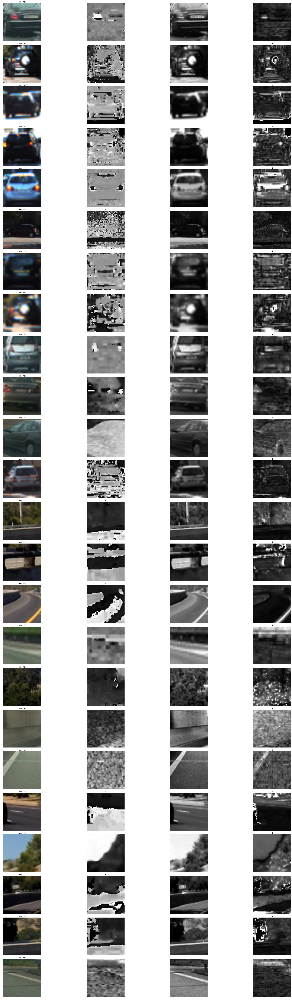

In [4]:
show_hls_images(samples)

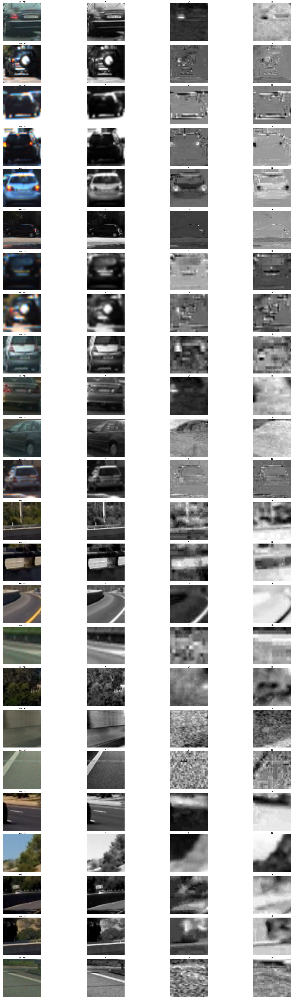

In [5]:
show_ycrcb_images(samples)

Looking at the above images, using S channel in HSV transformation seems to highlight cars well.

Using Cb channel in YCrCb transfomration also looks like a good alternate option.

### HOG features:

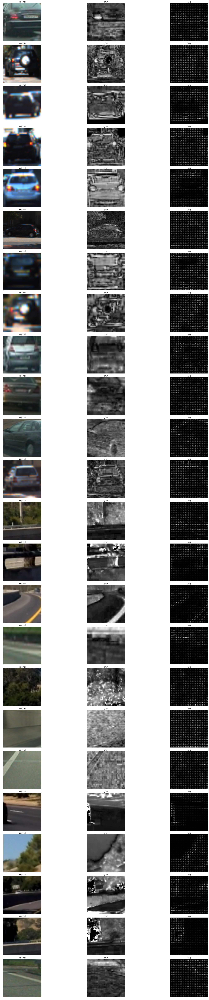

In [6]:
gray_samples = [convert_color_space_and_get_channel(img, 'HSV', 1) for img in samples]
hog_samples = [get_hog_features(gray, orientations=8, pixels_per_cell=4, cells_per_block=2, transform_sqrt=True, visualise=True)[1]
              for gray in gray_samples]

grid_plot( [("original", samples),
            ("gray", gray_samples),
            ("hog", hog_samples)])